In [144]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import (MultipleLocator,
                               FormatStrFormatter,
                               AutoMinorLocator)

df = pd.read_csv("Crime_Data_from_2020_to_Present.csv", converters={'TIME OCC': str}, index_col=False)

df["DATE OCC"] = pd.to_datetime(df["DATE OCC"].str.split(" ").str[0] + df["TIME OCC"], format='%m/%d/%Y%H%M')
df["Date Rptd"] = pd.to_datetime(df["Date Rptd"].str.split(" ").str[0], format='%m/%d/%Y')
df.drop(['DR_NO', 'TIME OCC', 'Part 1-2', 'Crm Cd 1', 'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4', 'Status', 'Status Desc', 'Cross Street', 'Premis Cd', 'Premis Desc', 'Weapon Used Cd', 'Weapon Desc', 'Mocodes'], axis=1, inplace=True)

# df = df.sort_values(by=["DATE OCC"]).reset_index(drop=True)

import datetime as dt

years = [2020, 2022, 2023]

crime_years = [df[df["DATE OCC"].dt.year == y] for y in years]
print(len(crime_years))

temp = pd.concat([crime_years[0], crime_years[1]])
crime_final = pd.concat([temp, crime_years[2]])

3


#### Usunięcie błędnych danych z szerokości i długości geograficznej

In [145]:
crime_final = crime_final[(crime_final["LON"] != 0) & (crime_final["LAT"] != 0)]

In [146]:
def time_to_float_hours(hour, minute, second):
    return hour + minute / 60. + second / 3600.

In [147]:
def prepare_and_normalize_dataset(crime_df):
    res = crime_df[['DATE OCC', 'LON', 'LAT']].copy()

    for label in ['DATE OCC', 'LON', 'LAT']:

        if label == 'DATE OCC':
            res['DATE OCC'] = time_to_float_hours(res['DATE OCC'].dt.hour, res['DATE OCC'].dt.minute, res['DATE OCC'].dt.second)
            temp = res[label].to_numpy()
            temp = temp.astype(float)
            fraction = temp / 24
            cyclic_time = 2*np.pi*fraction
            normalized = cyclic_time / (2* np.pi)
            temp = normalized

        else:
            temp = res[label].to_numpy()
            mean = np.mean(temp)
            std = np.std(temp)
            temp = (temp - mean)/std

        res[label] = temp
    
    return res

In [148]:
# Obliczanie estymatora wariancji j-tej współrzędnej: x -> wartości losowe, m -> liczba wartości


def calculate_Vj(x, m):
  sum_1 = np.sum(x**2)
  sum_2 = np.sum(x)

  return   (1. / (m - 1)) * sum_1 - (1. / (m*(m - 1))) * sum_2**2

# Czwarta pochodna funkcji K
def K_4(x):
  return (1. / np.sqrt(2*np.pi)) * (np.power(x, 4) - 6*np.power(x, 2) + 3) * np.exp(-x ** 2 / 2.)

# Szósta pochodna funkcji K
def K_6(x):
  return (1. / np.sqrt(2*np.pi)) * (np.power(x , 6.) - 15*np.power(x, 4) + 45*np.power(x, 2) - 15) * np.exp(-x ** 2 / 2.)


# Obliczanie współczynnika C: x -> wartości losowe, m -> liczba wartości, h -> współczynnik h (inny niż ten co mamy ostatecznie policzyć),
#                             xi -> współczynnik xi (ten taki grecki zawijas), K_n -> n-ta pochodna funkcji K

def calculate_C(x, m, h, xi, K_n):

  args = (x[:, None] - x[None, :]) / h
  vals = K_n(args)
  return (1. / (m**2 * np.power(h, xi + 1.))) * np.sum(vals)

# Obliczanie parametru wygładzania h: x -> zbiór wartości, m -> liczba wartości, h -> współczynnik h (inny niż ten co mamy ostatecznie policzyć),
#                                     xi -> współczynnik xi (ten taki grecki zawijas), K -> funkcja K, x0 -> przesunięcie funkcji K o stałe

def calculate_h(x, m):

  #1. Obliczamy estymator wariancji
  V = calculate_Vj(x, m)

  #2. Obliczamy estymator odchylenia standardowego
  sigma = np.sqrt(V)

  #3. Obliczamy wartośc c8
  c8 = 105. / (32. * np.sqrt(np.pi) * np.power(sigma, 9))

  #4. Obliczamy wartość hII
  #K6_0 -> szósta pochodna K w x = 0
  K6_0 = K_6(0.)

  Uk = 1.
  hII = np.power(((-2 * K6_0) / (Uk * c8 * m)), 1 / 9.)

  #5. Obliczamy wartość C6_h11
  C6_hII = calculate_C(x, m, hII, 6., K_6)

  #6. Obliczamy wartość hI, K4_0 -> wartość czwartej pochodnej K w punkcie 0
  K4_0 = K_4(0.)

  hI = np.power(((-2. * K4_0) / (Uk * C6_hII * m)), 1. / 7)

  #7. Obliczamy wartość C4_hI
  C4_hI = calculate_C(x, m, hI, 4., K_4)


  #8. Obliczamy h0, wiedząc że Z(f) = C4_hI
  Wk = 1. / (2 * np.sqrt(np.pi))
  h0 = np.power((Wk / (Uk ** 2 * C4_hI * m)), 1 / 5.)

  return h0

In [149]:
crimes_categories_names = ["Abuse", "Theft", "Fraud", "Property Damage / Theft", "Threats", "Sexual Crimes", "Other Crimes"]
crimes_categories_codes = [[110, 113, 230, 231, 235, 236, 237, 250, 251, 434, 435, 436, 622, 623, 624, 625, 626, 627, 870, 910, 920, 921, 922, 943],
                           [210, 220, 310, 320, 330, 331, 341, 343, 347, 349, 350, 351, 352, 353, 354, 410, 420, 421, 433, 440, 441, 442, 443, 444, 446, 450, 451, 452, 470, 471, 473, 474, 475],
                           [649, 651, 652, 653, 654, 660, 662, 664, 666, 668, 670, 942, 950, 951],
                           [647, 648, 740, 745, 888, 433, 438, 480, 485, 487, 510, 520, 522],
                           [940, 753, 755, 756, 763, 928, 933, 930],
                           [760, 762, 805, 806, 810, 812, 813, 814, 815, 820, 821, 822, 845, 850, 932, 956, 121, 122, 860],
                           [437, 439, 661, 761, 880, 886, 890, 900, 901, 902, 903, 906, 931, 944, 946, 949, 954, 865]]

In [160]:
def select_year_and_cathegory(crime_df, year=2020, category='Abuse'):

    if not year in [2020, 2022, 2023]:
        raise ValueError(f'Incorrect value for year - {year}. Years can only be 2020, 2022, 2022')
    elif not category in crimes_categories_names:
        raise ValueError(f'Incorrect value for category - {category}. Categories can only be {crimes_categories_names}')
    
    temp = crime_df.copy()
    temp = temp[temp['Crm Cd'].isin(crimes_categories_codes[crimes_categories_names.index(category)])].reset_index()
    temp = temp[temp['DATE OCC'].dt.year == year]

    return temp


In [161]:
def k(x, x0 = 0., h = 1.):
    return 1/np.sqrt(2*np.pi) * np.exp(-((x-x0)/h)**2/2)

def gauss_calc(x, x0, m, K = k, h=1.0):
  result = K(x, x0[0], h)
  for i in range(1, m):
    result += K(x, x0[i], h)
  result = result/(float(m)*h)
  return result

def gauss_calc_df(crime_df, m, K = k, h = 1.):
  temp = crime_df.copy()
  temp = temp.sample(n=m, random_state=12)

  normalized = prepare_and_normalize_dataset(temp)

  x_tab = {}
  gauss_res = {}
  gauss_to_original = {}
  for extract in ['DATE OCC', 'LON', 'LAT']:
    column = np.sort(normalized[extract].to_numpy())
    
    # if extract == 'DATE OCC':
    #   copy = temp[extract].dt.time.copy()
    # else:
    #   copy = temp[extract].copy()
    x = np.linspace(np.min(column), np.max(column), m)
    gauss = gauss_calc(x, column, m=m, K=k, h=h)
    gauss_res[extract] = gauss
    gauss_to_original[extract] = dict(zip(gauss, normalized[extract]))
    x_tab[extract] = x

  return gauss_res, x_tab, gauss_to_original, normalized

In [162]:
def calculate_h_for_features(samples, xs, m):
    new_hs = []
    new_samples = []
    columns = ['DATE OCC', 'LON', 'LAT']
    for col in columns:
        new_h = calculate_h(samples[col], m)
        new_sample = gauss_calc(xs[col], samples[col], m, h=new_h)

        new_hs.append(new_h)
        new_samples.append(new_sample)
    
    return new_samples, new_hs

In [163]:
# stwórz wariant do usuwania nietypowych pomiędzy kategoriami, np.: x i y, czas i y, czas i x

def determine_if_typical(r, m, vals, h):
  # gauss_y = gauss_calc(x, random_nums, m, K = k, h=1.0)
  gauss_y = []
  for i in range(m):
    # for j in range(m):
    temp = vals[np.arange(len(vals)) != i]
    gauss_y.append(gauss_calc(vals[i], temp, m - 1, K = k, h=h))

  typical_arr = {}
  gauss_y = dict(enumerate(gauss_y, 0))

  # q = estimate_q(gauss_y, r, m)
  gauss_y = sorted(gauss_y.items(), key=lambda x:x[1])
  gauss_y = dict(gauss_y)
  gauss_items = list(gauss_y.values())
  q = gauss_items[0 if  m*r < 0.5 else int(m*r + 0.5)]
  for idx, val in gauss_y.items():
    if idx < m:
      if val <= q:
        typical_arr[vals[idx]] = 1
      else:
        typical_arr[vals[idx]] = 0
  return typical_arr

In [164]:
def determine_if_typical_for_features(samples, r, m):
    typical_arrs = []
    categories = ['DATE OCC', 'LON', 'LAT']
    
    for cat in categories:
        typical_arr = determine_if_typical(r, m, samples[cat], 0.2)
        typical_arrs.append(typical_arr)

    return typical_arrs

In [165]:
cat_df = select_year_and_cathegory(crime_final, 2022, 'Theft')
gauss_res, _, gauss_to_origin, origin = gauss_calc_df(cat_df, 1000, h=0.5)

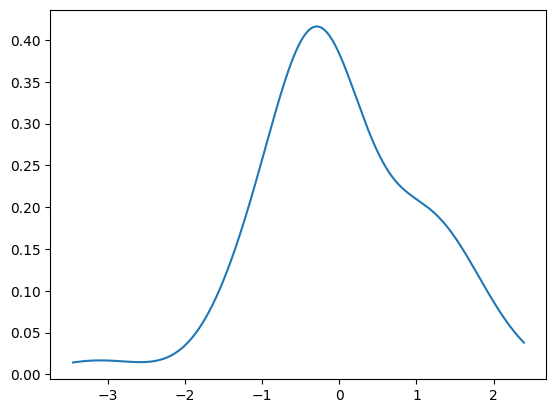

In [166]:
key = 'LAT'
plt.plot(np.linspace(min(origin[key]), max(origin[key]), 1000), gauss_res[key])
plt.show()

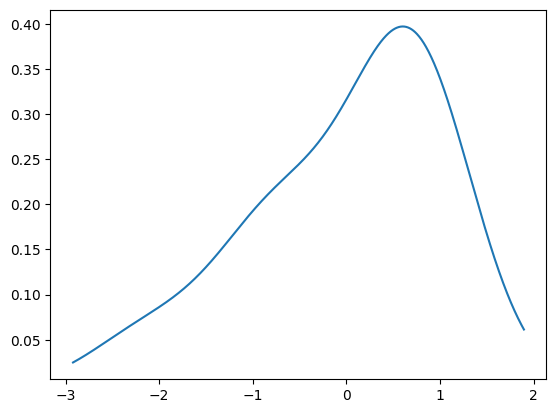

In [167]:
key = 'LON'
plt.plot(np.linspace(min(origin[key]), max(origin[key]), 1000), gauss_res[key])
plt.show()

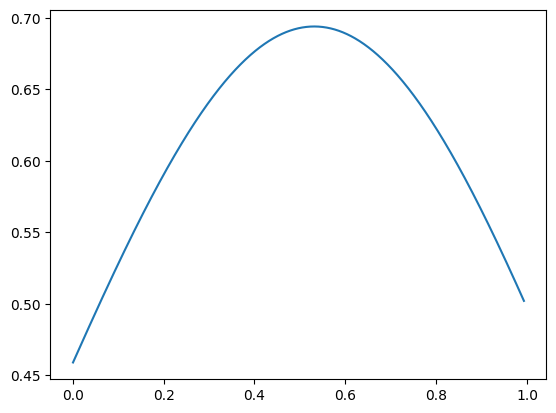

In [168]:
key = 'DATE OCC'
plt.plot(np.linspace(min(origin[key]), max(origin[key]), 1000), gauss_res[key])
plt.show()

In [169]:
r = 0.05
m = 1000
# year = 2023
h = 0.5
typical_dict = {}
origin_dict = {}
gauss_dict = {}
gauss_orig_dict = {}
x_dict = {}

for year in [2020, 2022, 2023]:
    for cat in crimes_categories_names:
        cat_df = select_year_and_cathegory(crime_final, year, cat)

        gauss_res, x_res, gauss_to_origin, origin = gauss_calc_df(cat_df, m, h)
        # gauss_res, hs = calculate_h_for_features(gauss_res, x_res, m)

        typical_arrs = determine_if_typical_for_features(gauss_res, r, m)

        typical_dict[str(year) + ' ' + cat] = typical_arrs
        origin_dict[str(year) + ' ' + cat] = origin
        gauss_orig_dict[str(year) + ' ' + cat] = gauss_to_origin
        gauss_dict[str(year) + ' ' + cat] = gauss_res
        x_dict[str(year) + ' ' + cat] = x_res

# display(typical_dict[year_crime_key][1])

In [170]:
year_crime_key = '2022 Theft'
len(gauss_dict[year_crime_key]['LON'])
# display(gauss_dict[year_crime_key]['LON'])

1000

In [171]:
# len(typical_dict[year_crime_key][0])

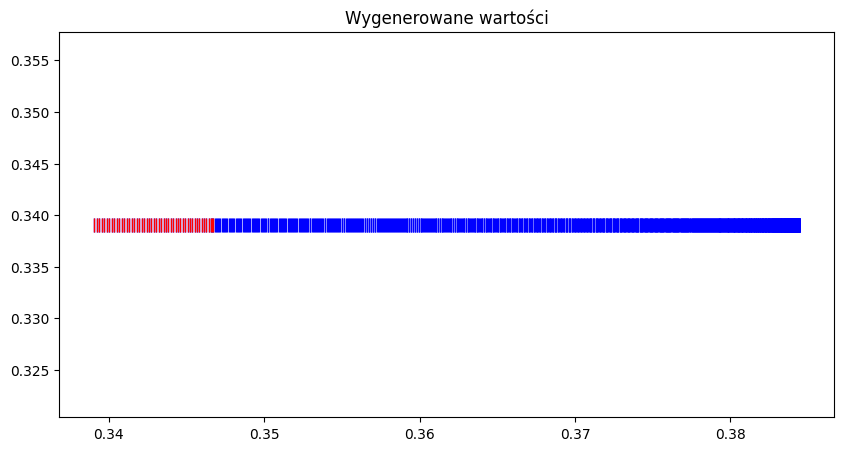

In [172]:
def plot_gauss(fun, fun_range):
    fig = plt.figure(figsize = (8,5))
    plt.plot(fun_range, fun)
    # plt.yticks(np.arange(0,0.55,0.1))
    plt.show()

def plot_colored_nums(data, num_of_points, typical, x_dict):
  fig, ax = plt.subplots(figsize=(10, 5))
  # ax.set_xlim(0, 10)
  # ax.set_ylim(0, 0.5)
  # ax.xaxis.set_major_locator(MultipleLocator(0.1))
  ax.set_title(f'Wygenerowane wartości')

#   atypical_nums = sum(typical.values())

  ax.scatter(data, np.full(num_of_points, np.min(data)), marker='|', c='blue', s=100, linewidths=1)
  for rand in data:
    if typical[rand] == 1:
      ax.scatter(rand, np.min(data), marker='|', c='red', s=100, linewidths=1)
  # plt.plot(x_dict, data)

plot_colored_nums(data=gauss_dict[year_crime_key]['DATE OCC'], num_of_points=m, typical=typical_dict[year_crime_key][0], x_dict=x_dict[year_crime_key]['DATE OCC'])

In [173]:
# fig, ax = plt.subplots(figsize=(10, 7))
# ax.set_title(f'Wygenerowane wartości')

# data = [gauss_orig_dict[year_crime_key]['DATE OCC'][key] for key in gauss_dict[year_crime_key][0]]

# for rand_1 in gauss_dict[year_crime_key][0]:
#     print(gauss_dict[year_crime_key][0])  
#     if typical_dict[year_crime_key][0][rand_1] == 1:
#             plt.scatter(gauss_orig_dict[year_crime_key]['DATE OCC'][rand_1],  0,  marker='.', c='red')


# plt.show()

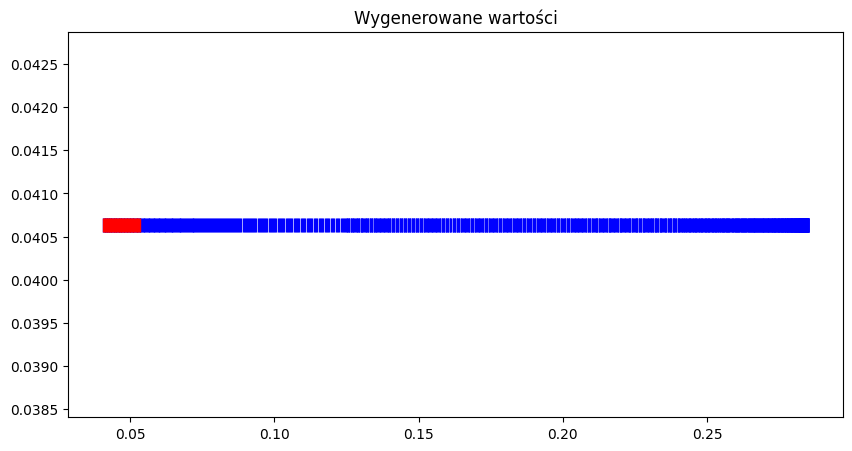

In [174]:
plot_colored_nums(data=gauss_dict[year_crime_key]['LON'], num_of_points=m, typical=typical_dict[year_crime_key][1], x_dict=x_dict[year_crime_key]['LON'])

In [175]:
for key in gauss_dict[year_crime_key]['LON']:
    if typical_dict[year_crime_key][1][key] == 1:
        print(gauss_orig_dict[year_crime_key]['LON'][key])

-1.7149930189741085
-0.8429846270354122
0.8894311582797666
0.45922746159159394
0.8662291611549275
-0.6003304071055882
0.7676206733747395
0.13343275196471616
1.09341538300148
0.5829714462569443
1.185256621620331
-1.8629057506443907
0.9261676537272796
0.5617029488925657
-0.019313729106579913
-1.0866055968453292
-2.2844086984107657
0.6757794347558883
1.0547453877936437
0.8468941635510095
0.952269900492672
1.209425368625263
0.7763214222965369
1.037343889950049
-0.701839144526467
0.4611609613519171
-2.265073700806848
-1.736261516338487
0.5017644563202137
-1.389198309347368
-0.7724118857809397
0.7347511774480101
-0.812048630869006
0.2881127327964727
-1.0024983572680453
0.3432174759678109
0.6632116863133072
0.2939132320777168
-1.5003745455701372
-0.44371692651350847
-0.6486679011155894
-0.9338591157740331
0.6709456853550119
0.6777129345163487
-0.019313729106579913
0.6197079417044572
0.3954219694984583
-0.3170726922076048
-1.9470129902216746
-0.5935631579442512
0.7125159302034013


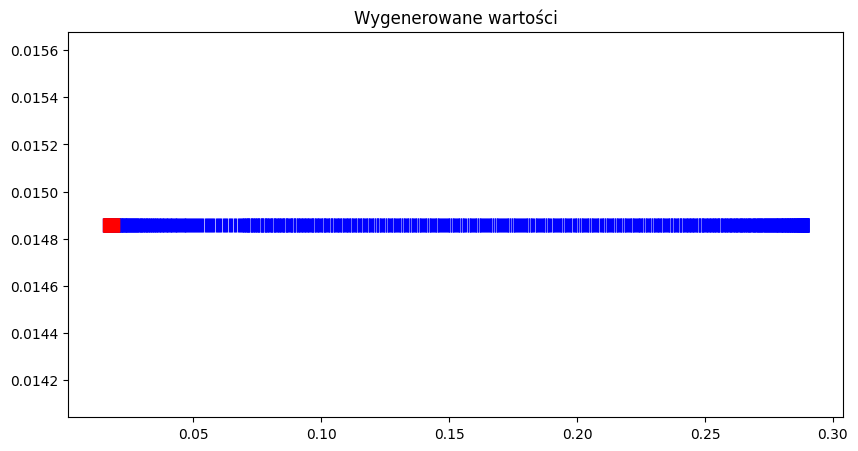

In [176]:
plot_colored_nums(data=gauss_dict[year_crime_key]['LAT'], num_of_points=m, typical=typical_dict[year_crime_key][2], x_dict=x_dict[year_crime_key]['LAT'])

In [177]:
count_lat, count_lon, count_date = 0,0,0

for key in gauss_dict[year_crime_key]['LAT']:
    if typical_dict[year_crime_key][2][key] == 1:
        count_lat += 1

for key in gauss_dict[year_crime_key]['LON']:
    if typical_dict[year_crime_key][1][key] == 1:
        count_lon += 1

for key in gauss_dict[year_crime_key]['DATE OCC']:
    if typical_dict[year_crime_key][0][key] == 1:
        count_date += 1
    

print(f'{count_lat}: LAT and {count_lon}: LON and {count_date}: DATE OCC')


51: LAT and 51: LON and 51: DATE OCC


In [185]:
def plot_typical_2D(gauss, typical, gauss_to_origin, index=0, title = ""):
    fig, ax = plt.subplots(figsize=(10, 7))
    ax.set_title(title)
    
    cat_x = 'LON'
    cat_y = 'LAT'
    # index2 = 2 if index == 1 else 1

    # print(gauss[cat])
    # print(gauss_to_origin[cat_x])
    
    x, y = [gauss_to_origin[cat_x][key] for key in gauss['LON']], [gauss_to_origin[cat_y][key] for key in gauss['LAT']]
    plt.scatter(x, y, marker='.', c='blue')
        
    for rand_1, rand_2 in zip(gauss[cat_x], gauss[cat_y]):  
        if typical[1][rand_1] == 1 and typical[2][rand_2] == 1:
            plt.scatter(gauss_to_origin[cat_x][rand_1],  gauss_to_origin[cat_y][rand_2],  marker='.', c='red')
        if typical[2][rand_2] == 1 and typical[1][rand_1] == 0:
            plt.scatter(gauss_to_origin[cat_x][rand_1],  gauss_to_origin[cat_y][rand_2],  marker='.', c='pink')
        if typical[1][rand_1] == 1 and typical[2][rand_2] == 0:
            plt.scatter(gauss_to_origin[cat_x][rand_1],  gauss_to_origin[cat_y][rand_2],  marker='.', c='black')

    plt.show()

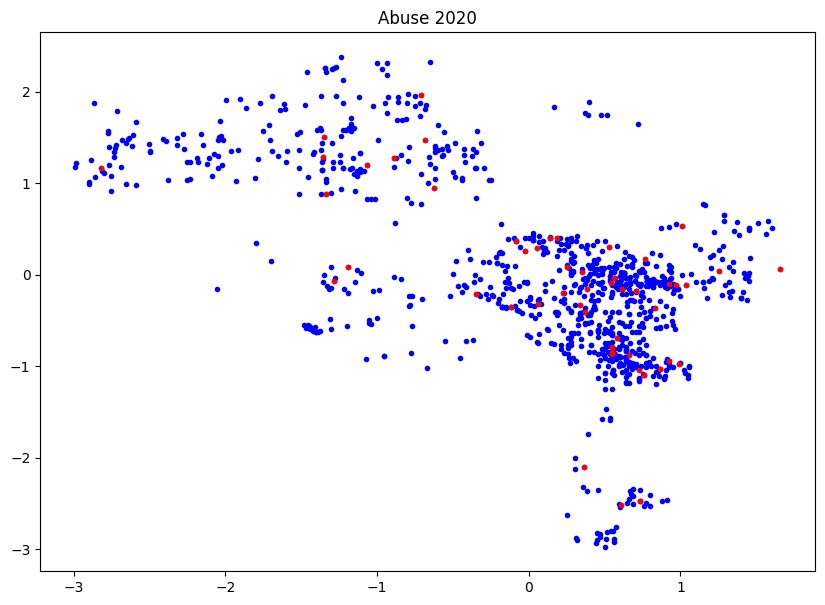

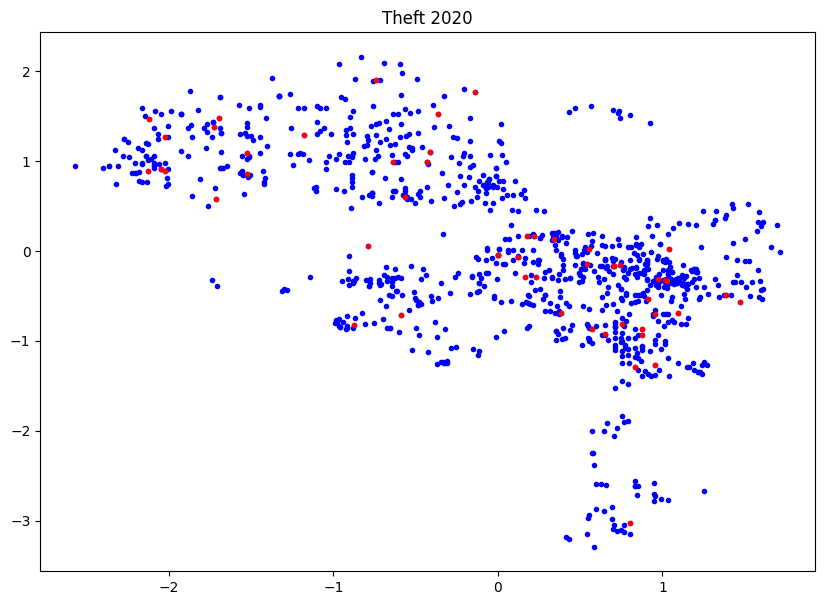

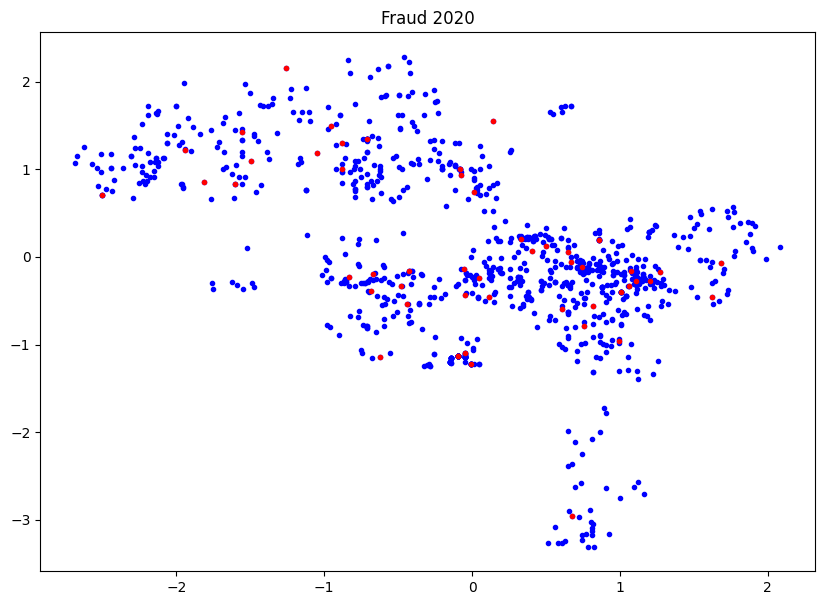

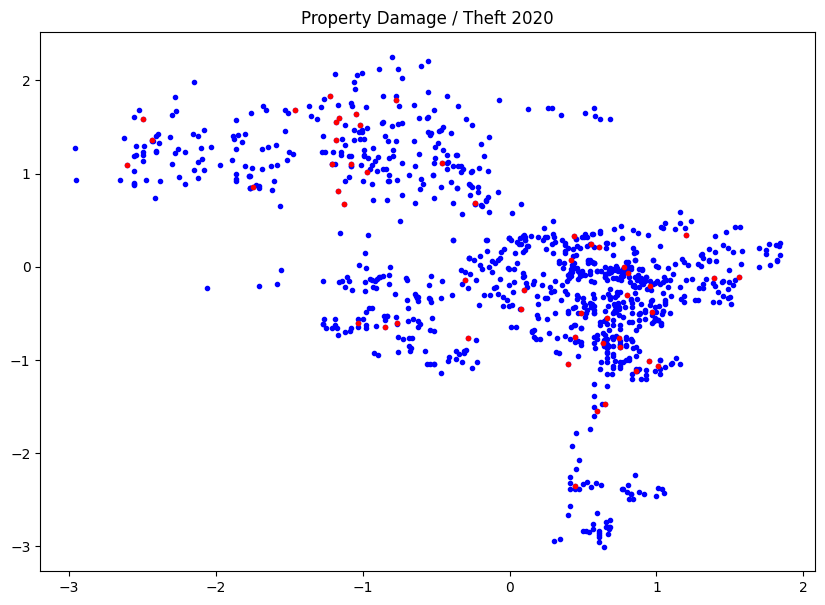

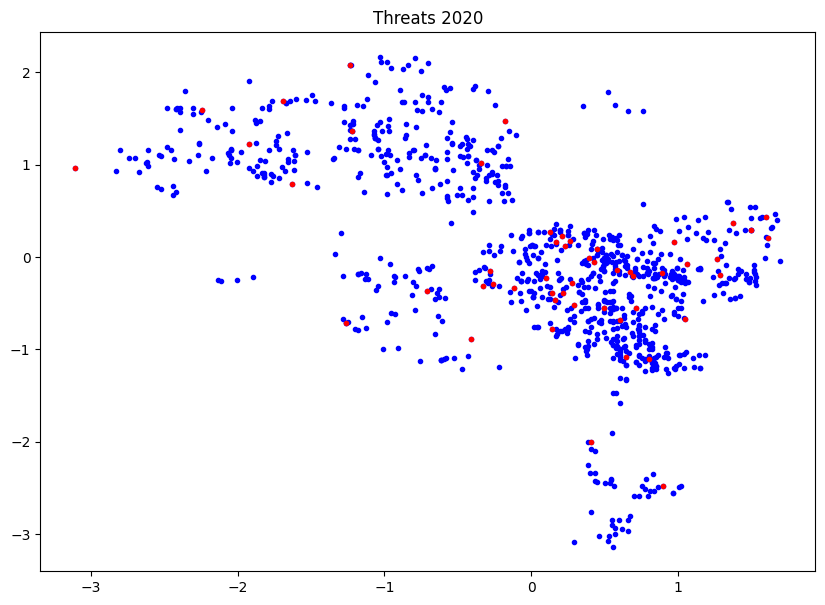

...

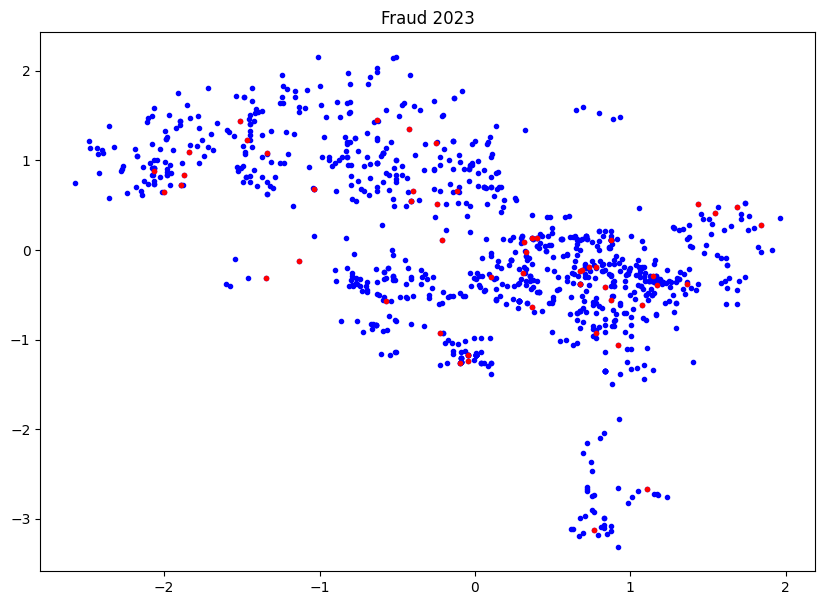

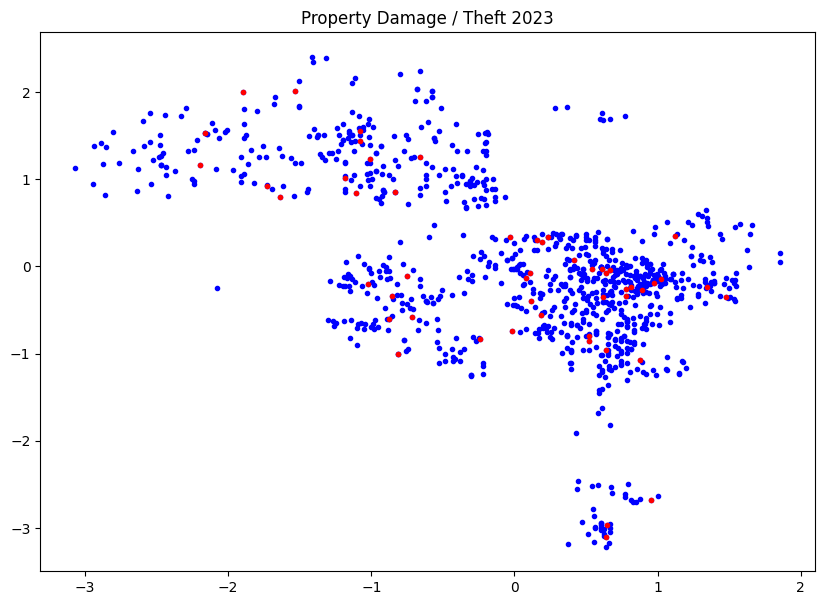

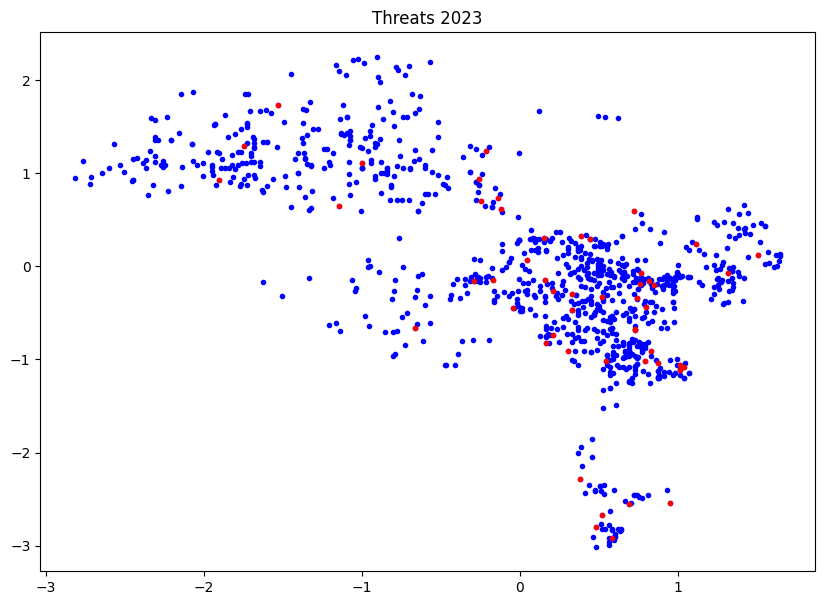

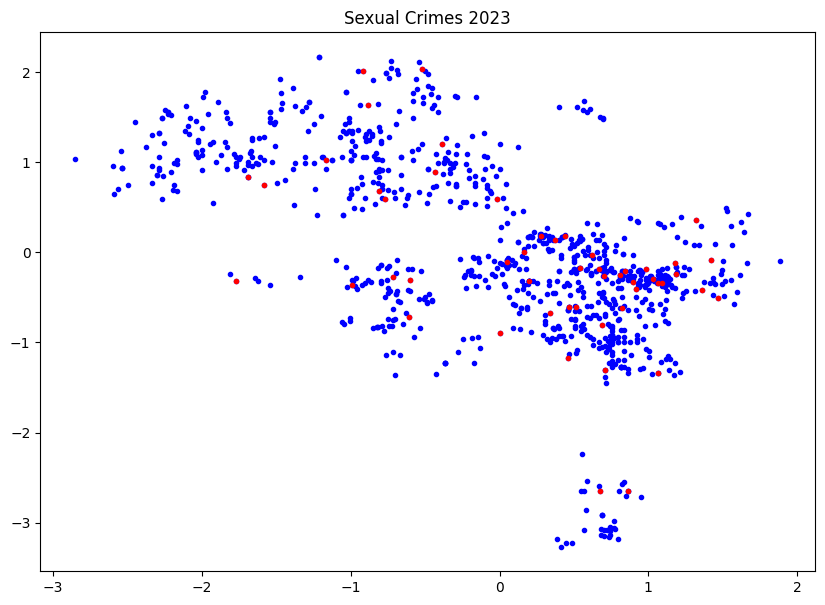

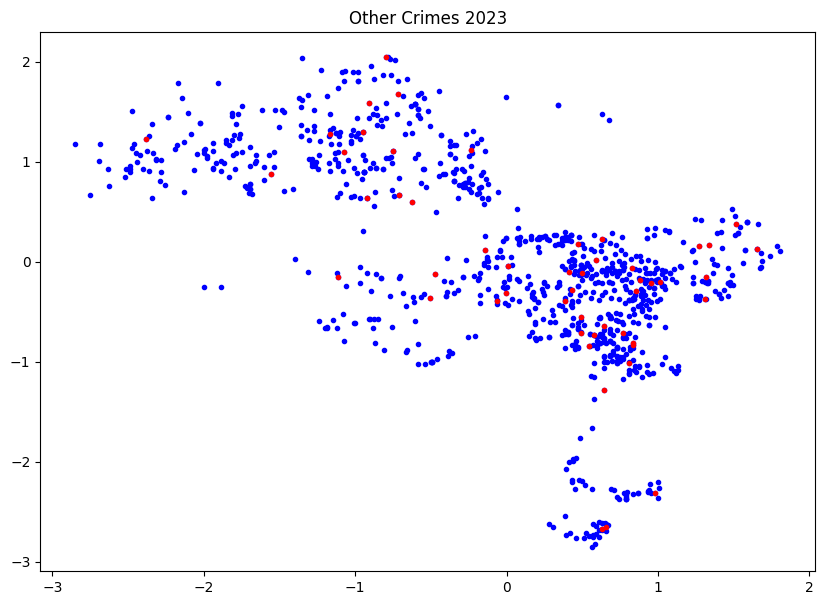

In [191]:
years = [2020, 2022, 2023]
for year in years:
    for crime in crimes_categories_names:
        plot_typical_2D(gauss_dict[str(year) + ' ' + crime], typical_dict[str(year) + ' ' + crime], gauss_orig_dict[str(year) + ' ' + crime], title=crime + ' ' + str(year))

In [192]:
def plot_typical_2D_both(gauss, typical, gauss_to_origin, index):
    fig, ax = plt.subplots(figsize=(10, 7))
    ax.set_title(f'Wygenerowane wartości')
    
    cat_x = 'LON'
    cat_y = 'LAT'
    cat = cat_x if index == 1 else cat_y
    cat2 = cat_y if index == 1 else cat_x
    
    x, y = gauss[cat_x], gauss[cat_y]
    print(len(gauss))
    
    plt.scatter(x, y, marker='.', c='blue')
  
    for rand_1, rand_2 in zip(gauss[cat], gauss[cat2]):
        print(gauss[cat])
        if index == 1:    
            if typical[index][rand_1] == 1:
                plt.scatter(rand_1, rand_2, marker='.', c='red')
        else:
            if typical[index][rand_1] == 1:
                plt.scatter(rand_2, rand_1, marker='.', c='red')

    plt.show()

3
[0.04063684 0.04086916 0.04110232 0.04133632 0.04157116 0.04180685
 0.04204339 0.04228077 0.04251899 0.04275806 0.04299797 0.04323873
 0.04348034 0.04372279 0.04396609 0.04421024 0.04445523 0.04470107
 0.04494776 0.0451953  0.04544369 0.04569292 0.04594301 0.04619394
 0.04644572 0.04669835 0.04695183 0.04720616 0.04746135 0.04771738
 0.04797426 0.04823199 0.04849057 0.04875    0.04901029 0.04927142
 0.04953341 0.04979624 0.05005993 0.05032447 0.05058986 0.0508561
 0.05112319 0.05139114 0.05165993 0.05192958 0.05220008 0.05247143
 0.05274363 0.05301669 0.05329059 0.05356535 0.05384096 0.05411742
 0.05439473 0.05467289 0.0549519  0.05523177 0.05551249 0.05579405
 0.05607647 0.05635974 0.05664386 0.05692884 0.05721466 0.05750133
 0.05778886 0.05807723 0.05836645 0.05865653 0.05894745 0.05923923
 0.05953185 0.05982532 0.06011964 0.06041481 0.06071083 0.0610077
 0.06130542 0.06160398 0.0619034  0.06220366 0.06250477 0.06280672
 0.06310952 0.06341317 0.06371767 0.06402301 0.0643292  0.0646

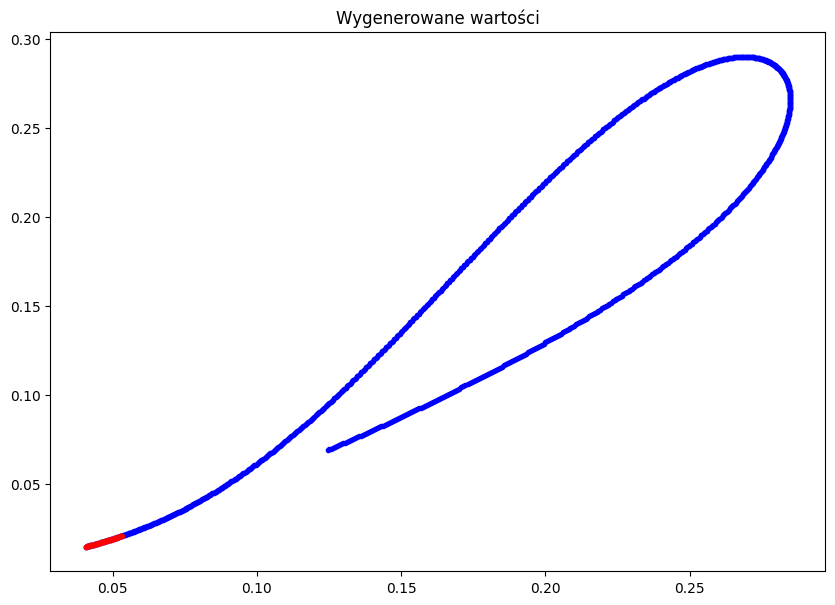

In [193]:
plot_typical_2D_both(gauss_dict[year_crime_key], typical_dict[year_crime_key], gauss_orig_dict[year_crime_key], 1)

3
[0.0148591  0.01496043 0.01506256 0.01516549 0.01526923 0.01537378
 0.01547917 0.01558539 0.01569246 0.01580039 0.01590918 0.01601885
 0.0161294  0.01624084 0.01635319 0.01646645 0.01658063 0.01669575
 0.0168118  0.01692881 0.01704679 0.01716574 0.01728567 0.01740659
 0.01752852 0.01765146 0.01777543 0.01790044 0.01802649 0.0181536
 0.01828178 0.01841103 0.01854138 0.01867283 0.01880539 0.01893908
 0.0190739  0.01920987 0.019347   0.0194853  0.01962478 0.01976545
 0.01990733 0.02005043 0.02019475 0.02034032 0.02048714 0.02063523
 0.02078459 0.02093524 0.0210872  0.02124047 0.02139506 0.021551
 0.02170829 0.02186694 0.02202697 0.0221884  0.02235122 0.02251546
 0.02268113 0.02284824 0.02301681 0.02318685 0.02335836 0.02353138
 0.0237059  0.02388194 0.02405951 0.02423864 0.02441932 0.02460158
 0.02478543 0.02497088 0.02515795 0.02534665 0.02553699 0.02572898
 0.02592265 0.02611801 0.02631506 0.02651382 0.02671431 0.02691654
 0.02712053 0.02732628 0.02753381 0.02774315 0.02795429 0.02816

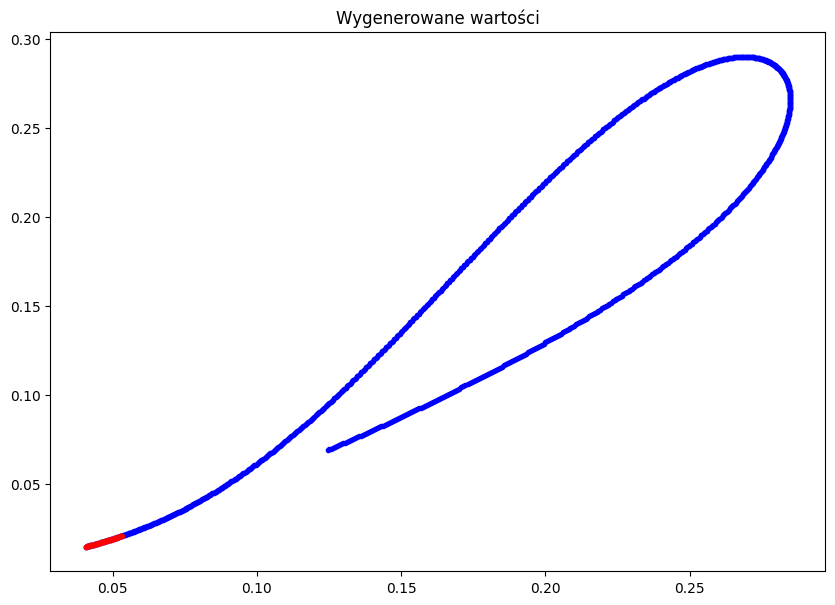

In [194]:
plot_typical_2D_both(gauss_dict[year_crime_key], typical_dict[year_crime_key], gauss_orig_dict[year_crime_key], 2)

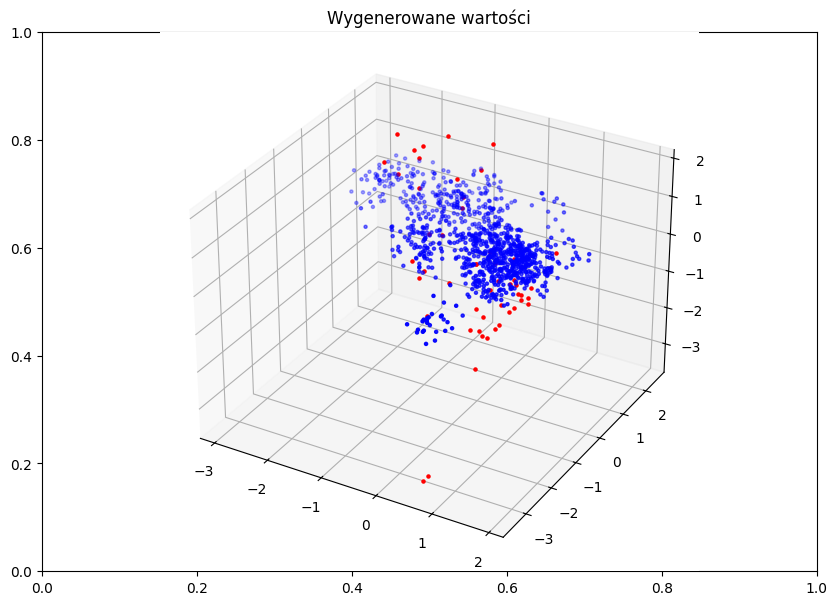

In [195]:
def plot_typical_3D(gauss, typical, gauss_to_origin, index=0):
    fig, ax = plt.subplots(figsize=(10, 7))
    ax.set_title(f'Wygenerowane wartości')
    
    cat_x = 'LON'
    cat_y = 'LAT'
    cat_z = 'DATE OCC'
    # index2 = 2 if index == 1 else 1

    # print(gauss[cat])
    # print(gauss_to_origin[cat_x])
    
    ax = fig.add_subplot(111, projection='3d')
    x, y, z = [gauss_to_origin[cat_x][key] for key in gauss['LON']], [gauss_to_origin[cat_y][key] for key in gauss['LAT']], [gauss_to_origin[cat_z][key] for key in gauss['DATE OCC']]
    ax.scatter(x, y, z, marker='.', c='blue')
        
    for rand_1, rand_2, rand_3 in zip(gauss[cat_x], gauss[cat_y], gauss[cat_z]):  
        if typical[1][rand_1] == 1 or typical[2][rand_2] == 1 or typical[0][rand_3]:
            ax.scatter(gauss_to_origin[cat_x][rand_1],  gauss_to_origin[cat_y][rand_2], gauss_to_origin[cat_y][rand_2],  marker='.', c='red')

    plt.show()

plot_typical_3D(gauss_dict[year_crime_key], typical_dict[year_crime_key], gauss_orig_dict[year_crime_key])